<a href="https://colab.research.google.com/github/parasgulati8/Data-Analysis/blob/master/PLM_Assignment.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [1]:
cd 'drive/My Drive/Colab Notebooks/data for PLM data challenge for DSE'

/content/drive/My Drive/Colab Notebooks/data for PLM data challenge for DSE


# Imports

In [92]:
import pandas as pd
import numpy as np
import seaborn as sns
import matplotlib.pyplot as plt
from functools import reduce
import tqdm
import plotly.express as px
import plotly.graph_objects as go
from sklearn.metrics import accuracy_score
from sklearn.model_selection import train_test_split, StratifiedKFold
from sklearn.ensemble import RandomForestClassifier
from sklearn.neighbors import KNeighborsClassifier
from sklearn.metrics import classification_report
from sklearn.decomposition import PCA
from statsmodels.tsa.stattools import adfuller
from statsmodels.tsa.stattools import acf, pacf
from statsmodels.tsa.seasonal import seasonal_decompose
from statsmodels.tsa.arima_model import ARIMA
from matplotlib.pylab import rcParams
rcParams['figure.figsize'] = 10, 6
import tensorflow as tf
from tensorflow.keras.layers import Dense, ReLU, PReLU
from tensorflow.keras.models import Sequential, load_model
from tensorflow.keras.callbacks import ModelCheckpoint
from tensorflow.keras.initializers import glorot_uniform

In [5]:
alsfrs_score = pd.read_csv('user_ALSFRS_score.csv')
onset_date = pd.read_csv('user_onset_date.csv')
condition = pd.read_csv('user_condition.csv')
symptom = pd.read_csv('user_symptom.csv')

In [6]:
tables = [alsfrs_score, condition, onset_date, symptom]
drop_unnamed = map(lambda x : x.drop('Unnamed: 0', axis=1, inplace = True), tables)
list(drop_unnamed)

[None, None, None, None]

# EDA

In [85]:
alsfrs_score.head()

,user_id,report_date,score
0,2520,2005-08-05,36
1,2520,2002-01-04,44
2,2520,2006-12-08,28
3,2520,2006-08-04,29
4,2520,2007-04-13,29


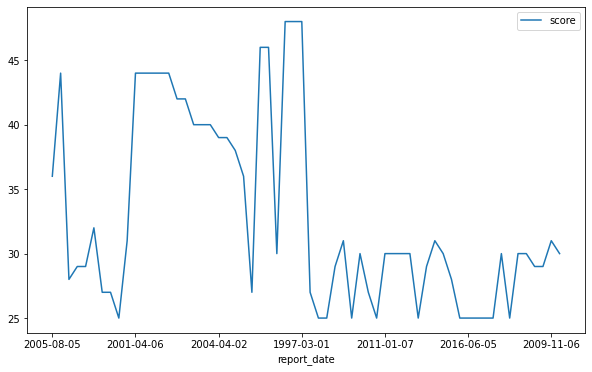

In [93]:
alsfrs_score[alsfrs_score.user_id == 2520].set_index('report_date').drop('user_id', axis = 1).plot()
# alsfrs_score.set_index('report_date')

In [100]:
def plot_alsfrs(user):
  indexedDataset = alsfrs_score[alsfrs_score.user_id == user].set_index('report_date').drop('user_id', axis = 1)
  rolmean = indexedDataset.rolling(window=12).mean()
  rolstd = indexedDataset.rolling(window=12).std()
  orig = plt.plot(indexedDataset, color='blue', label='Original')
  mean = plt.plot(rolmean, color='red', label='Rolling Mean')
  std = plt.plot(rolstd, color='black', label='Rolling Std')
  plt.legend(loc='best')
  plt.title('Rolling Mean & Standard Deviation')
  plt.show(block=False)

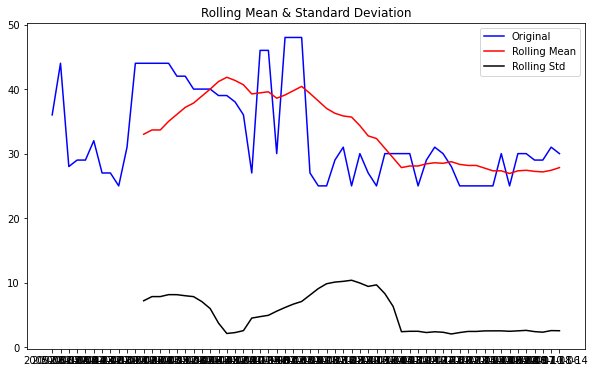

In [101]:
plot_alsfrs(2520)

In [102]:
#Perform Augmented Dickey–Fuller test:
def dickey_fuller_test(user):
  indexedDataset = alsfrs_score[alsfrs_score.user_id == user].set_index('report_date').drop('user_id', axis = 1)
  print('Results of Dickey Fuller Test:')
  dftest = adfuller(indexedDataset['score'], autolag='AIC')

  dfoutput = pd.Series(dftest[0:4], index=['Test Statistic','p-value','#Lags Used','Number of Observations Used'])
  for key,value in dftest[4].items():
    dfoutput['Critical Value (%s)'%key] = value
    
  print(dfoutput)

dickey_fuller_test(2520)

Results of Dickey Fuller Test:
Test Statistic                 -3.491869
p-value                         0.008198
#Lags Used                      0.000000
Number of Observations Used    61.000000
Critical Value (1%)            -3.542413
Critical Value (5%)            -2.910236
Critical Value (10%)           -2.592745
dtype: float64


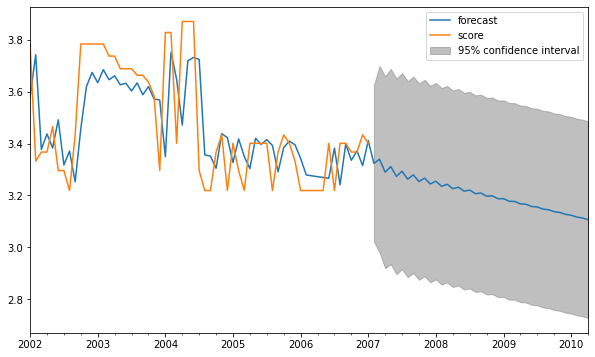

In [134]:
# AR+I+MA = ARIMA model
def plot_arima(user):
  indexedDataset = alsfrs_score[alsfrs_score.user_id == user].set_index('report_date').drop('user_id', axis = 1)
  indexedDataset.index = pd.DatetimeIndex(indexedDataset.index).to_period('M')
  indexedDataset_logScale = np.log(indexedDataset)
  datasetLogDiffShifting = indexedDataset_logScale - indexedDataset_logScale.shift()
  datasetLogDiffShifting.dropna(inplace=True)
  model = ARIMA(indexedDataset_logScale, order=(2,1,2))
  results_ARIMA = model.fit(disp=-1)
  results_ARIMA.plot_predict(1,100) 

plot_arima(2520)

## Plotting the declining scores with first definitive diagnosis date

In [140]:
# fig = go.Figure()

# fig.add_trace(go.scatter(x=alsfrs_score.report_date.values, y=alsfrs_score.score.values,
#                     mode='lines',
#                     name='lines'))
def plot_scores(user):
  fig = px.scatter(alsfrs_score[alsfrs_score.user_id == user], x="report_date", y="score")
  start_date = onset_date[onset_date.user_id == user].first_definitive_diagnosis_date.values
  if start_date:
    fig.update_layout(shapes=[
        dict(
          type= 'line',
          yref= 'paper', y0= 0, y1= 1,
          xref= 'x', 
          x0= (onset_date[onset_date.user_id == user].first_definitive_diagnosis_date.values[0]) , x1= (onset_date[onset_date.user_id == user].first_definitive_diagnosis_date.values[0]),
          name = 'Starting Date'
        )])
  fig.show()

plot_scores(2520)

## Number of Patients in each condition mentioned in condition table

In [8]:
fig = px.histogram(condition, x='condition_name')
fig.show()

In [30]:
fig = px.histogram(symptom, x='symptom_name')
fig.show()

## Top 20 Symptoms of Patients

In [144]:
def plot_top_20_symptoms(severity):
  common_symptoms = (symptom[symptom.symptom_severity_score == severity].symptom_name.value_counts().reset_index()).rename({'index' : 'symptom_name', 'symptom_name':'counts'}, axis = 1).iloc[:20, :]
  fig = px.bar(common_symptoms, x='symptom_name', y = 'counts')
  fig.show()

### Top 20 Symptoms of Patients with severity 4

In [145]:
plot_top_20_symptoms(4)

### Top 20 Symptoms of Patients with severity 3

In [141]:
plot_top_20_symptoms(3)

### Top 20 Symptoms of Patients with severity 2

In [142]:
plot_top_20_symptoms(2)

### Top 20 Symptoms of Patients with severity 1

In [143]:
plot_top_20_symptoms(1)

## Symptoms of a given Condition

In [147]:
def plot_conditions_symptoms(severity, condition_name):
  fig = px.bar((symp_cond[(symp_cond.symptom_severity_score == severity) & (symp_cond.condition_name == condition_name)].symptom_name.value_counts().reset_index()).rename({'index' : 'symptom_name', 'symptom_name':'counts'}, axis = 1).iloc[:20, :], x='symptom_name', y = 'counts')
  fig.show()

### Symptoms of a given condition with severity 4

In [149]:
plot_conditions_symptoms(4, 'fibromyalgia')

## Cleaning Symptom Names from Symptoms table

In [150]:
symptom.symptom_name.replace('[^a-zA-Z ]', "", regex=True, inplace=True)

In [151]:
symp_cond = pd.merge(symptom, condition, 'left', on= 'user_id')

In [152]:
symp_cond.head()

,user_id,symptom_name,symptom_severity_score,condition_name
0,43943,TMJ temporomandibular joint pain,1.0,fibromyalgia
1,146585,atrophy of right hand muscles,4.0,amyotrophic lateral sclerosis
2,146585,pain in right hand,1.0,amyotrophic lateral sclerosis
3,146585,slow speech bradyarthria,3.0,amyotrophic lateral sclerosis
4,146585,stiffness in right leg,4.0,amyotrophic lateral sclerosis


In [5]:
condition.head()

,user_id,condition_name
0,44386,generalized anxiety disorder
1,363068,fibromyalgia
2,363068,rheumatoid arthritis
3,363068,systemic lupus erythematosus
4,43943,fibromyalgia


In [9]:
# count the number of conditions each user is suffering from
condition_counts  = condition.groupby(by='user_id').count().reset_index().rename({'condition_name': 'condition_count'}, axis = 1)

In [10]:
# filter those users suffering from only one condition
single_condition_symptoms = pd.merge(condition_counts[condition_counts.condition_count == 1], symptom, how='left', on='user_id').dropna().drop('condition_count', axis = 1)

In [11]:
single_condition_symptoms.head()

,user_id,symptom_name,symptom_severity_score
33,43,bladder problems,4.0
34,43,bowel problems,3.0
35,43,brain fog,1.0
36,43,mood swings,2.0
38,45,acid reflux,3.0


In [12]:
# selecting top 50 symptoms observed among users, suffering from only one condition
top_50_symptoms = pd.DataFrame(single_condition_symptoms.symptom_name.value_counts()[:50]).reset_index().rename({'index': 'symptom_name', 'symptom_name':'count'}, axis = 1)

# Building Model

## Considering all the symptoms toether for predicting the condition

In [88]:
# convert the categorical symptoms to one hot encodings
symptom_oh= pd.get_dummies(single_condition_symptoms, columns=['symptom_name'], prefix='', prefix_sep='' )

In [89]:
symptom_oh.head()

,user_id,symptom_severity_score,bottom of left perception,perception of left thigh,perception of the left leg,perception of the left stomach,perception of the right buttocks,perception of the right leg,perception of the right stomach,perception of the right thigh,hearing loss right ear intermittent,to day recovery period epilepsy,AV fistula for dialysis,Babinski sign,Burkholderia cenocepacia infection,CBC blood work,CFSinduced depression,CO level,Charcot foot both feet,Copaxone flush,DM,EhlersDanlos syndrome hypermobility type,GI problems,HIV related neurological symptoms,HIVrelated arthritis,Hashimotos thyroiditis,I am able to walk without a walker for a few feet then push it away and walk to it,I couldnt bear weight on my leg,I felt like everything was trying to attack me,I have no interest in daily activities or a mind to do anything,I have no memory or I cant answer questions,I have some difficulty with my right leg and now walk using a cane,I was told that the medication would injure or add problems with my liver if I used it a lot,IPF exacerbation,JC virus present in blood test,JarischHerxeimer reaction,Klebseilla UTI,Lewy body Parkinsons disease,Lhermittes sign,Lyme disease,...,white coated tongue,whole body ache,whole body burning pain,whole body hurts to the touch,whole body joint ache,whole body muscle twitching fasciculations,whole body pain,whole body paresthesia,whole body shaking,whole body shooting pains,wide stance gait,wisdom teeth removed,withdrawal between doses,withdrawal effects,withdrawal reaction,woke from sleep coughing choking and short of breath,wont answer phone calls,word deafness,word finding difficulty,word fishing,work day,worrying about my future,worrying about my love leaving me because of my illnesses,worsening burning feeling at calves feet toes,worsening depression,worsening of old symptoms and gradual onset of newer symptomscurrently testing for other possible diseases,worsening posture,worsening vision,worthless feeling,wound infection,writing changes,wwhen med off stiffness in legs and jerking of right leg,wxman,yawning causes jaw spasms,yeast infection candida,yellow colored urine,yellow teeth,yoyo effect alternating sleepiness and energy,zinging and poking in my brain,zsd
33,43,4.0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0
34,43,3.0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0
35,43,1.0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0
36,43,2.0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0
38,45,3.0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0


In [113]:
# multiplying the severity score of the symptom with one-hot encoded vector of symptom
# adding all the one-hot enoded symptoms of a user together.
# A user has been represented with a single row. For example, user x has four symptoms each having severity of 1,2,3,4 respectively, then the symtoms vector will look like [0,0,1,.0,..2,..0..,4.. 0,0,0,0]


final = pd.DataFrame(columns=symptom_oh.columns)
final.drop(columns=['symptom_severity_score', 'condition_name'], inplace =True)
for i in tqdm.tqdm_notebook(symptom_oh.user_id.unique()):
  temp = pd.DataFrame(symptom_oh[symptom_oh.user_id == i].iloc[:, 2:].multiply(symptom_oh[symptom_oh.user_id == i].symptom_severity_score, axis = 0).sum()).T
  temp['user_id'] = i
  final = pd.concat([final,temp])

/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:2: TqdmDeprecationWarning:

This function will be removed in tqdm==5.0.0
Please use `tqdm.notebook.tqdm` instead of `tqdm.tqdm_notebook`



In [115]:
final.to_csv('Symptoms_oh.csv', index_label=False)

In [39]:
final = pd.read_csv('Symptoms_oh.csv')

In [40]:
df = pd.merge(final, condition, on='user_id')
X = df.iloc[:, 1:-1]
y = df.condition_name

In [41]:
df.head()

,user_id,bottom of left perception,perception of left thigh,perception of the left leg,perception of the left stomach,perception of the right buttocks,perception of the right leg,perception of the right stomach,perception of the right thigh,hearing loss right ear intermittent,to day recovery period epilepsy,AV fistula for dialysis,Babinski sign,Burkholderia cenocepacia infection,CBC blood work,CFSinduced depression,CO level,Charcot foot both feet,Copaxone flush,DM,EhlersDanlos syndrome hypermobility type,GI problems,HIV related neurological symptoms,HIVrelated arthritis,Hashimotos thyroiditis,I am able to walk without a walker for a few feet then push it away and walk to it,I couldnt bear weight on my leg,I felt like everything was trying to attack me,I have no interest in daily activities or a mind to do anything,I have no memory or I cant answer questions,I have some difficulty with my right leg and now walk using a cane,I was told that the medication would injure or add problems with my liver if I used it a lot,IPF exacerbation,JC virus present in blood test,JarischHerxeimer reaction,Klebseilla UTI,Lewy body Parkinsons disease,Lhermittes sign,Lyme disease,M pneumoniae,...,whole body ache,whole body burning pain,whole body hurts to the touch,whole body joint ache,whole body muscle twitching fasciculations,whole body pain,whole body paresthesia,whole body shaking,whole body shooting pains,wide stance gait,wisdom teeth removed,withdrawal between doses,withdrawal effects,withdrawal reaction,woke from sleep coughing choking and short of breath,wont answer phone calls,word deafness,word finding difficulty,word fishing,work day,worrying about my future,worrying about my love leaving me because of my illnesses,worsening burning feeling at calves feet toes,worsening depression,worsening of old symptoms and gradual onset of newer symptomscurrently testing for other possible diseases,worsening posture,worsening vision,worthless feeling,wound infection,writing changes,wwhen med off stiffness in legs and jerking of right leg,wxman,yawning causes jaw spasms,yeast infection candida,yellow colored urine,yellow teeth,yoyo effect alternating sleepiness and energy,zinging and poking in my brain,zsd,condition_name
0,43,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,multiple sclerosis
1,45,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,multiple sclerosis
2,50,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,multiple sclerosis
3,57,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,amyotrophic lateral sclerosis
4,59,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,fibromyalgia


In [66]:
df = pd.merge(final, condition, on='user_id')
X = df.iloc[:, 1:-1]
y = df.condition_name

folds = list(StratifiedKFold(n_splits=k, shuffle=True, random_state=1).split(X.values, y.values))
fold = folds[0]
X_train, X_test, y_train, y_test = X.values[fold[0]], X.values[fold[1]], y.values[fold[0]], y.values[fold[1]]
# converting the labels to one-hot vectors
y_train, y_test = pd.get_dummies(y_train), pd.get_dummies(y_test)

## Random Forest

In [159]:
# random forest classification to classify condition based on given symptoms data

rfc = RandomForestClassifier(200)
rfc.fit(X_train, y_train)
y_pred = rfc.predict(X_test)

In [160]:
print(classification_report(y_test, y_pred, target_names=y_test.columns))

                                                    precision    recall  f1-score   support

                               Parkinson's disease       0.85      0.68      0.75       341
                     amyotrophic lateral sclerosis       0.89      0.72      0.80       351
                                  bipolar disorder       0.91      0.74      0.82       129
                                   diabetes type 2       0.29      0.08      0.12        51
                                          epilepsy       0.63      0.28      0.39        85
                                      fibromyalgia       0.83      0.69      0.75       672
                      generalized anxiety disorder       0.00      0.00      0.00        36
                high blood pressure (hypertension)       0.39      0.22      0.28        41
           high cholesterol (hypercholesterolemia)       0.00      0.00      0.00         5
                                    hypothyroidism       1.00      0.53      0.

/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1272: UndefinedMetricWarning:

Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.

/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1272: UndefinedMetricWarning:

Precision and F-score are ill-defined and being set to 0.0 in samples with no predicted labels. Use `zero_division` parameter to control this behavior.



In [162]:
rfc.score(X_test, y_test)

0.6902220940294203

## Neural Networks

In [154]:
# Model architecture

model = Sequential()
model.add(Dense(64, activation='relu', input_dim=4350, kernel_initializer=glorot_uniform(seed=42)))
model.add(Dense(32, activation='relu', kernel_initializer=glorot_uniform(seed=42)))
model.add(Dense(20, activation='softmax', kernel_initializer=glorot_uniform(seed=42)))
model.summary()

Model: "sequential_13"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense_42 (Dense)             (None, 64)                278464    
_________________________________________________________________
dense_43 (Dense)             (None, 32)                2080      
_________________________________________________________________
dense_44 (Dense)             (None, 20)                660       
Total params: 281,204
Trainable params: 281,204
Non-trainable params: 0
_________________________________________________________________


In [155]:
model.compile(optimizer='adam',
              loss='categorical_crossentropy',
              metrics=['accuracy'])
mc = ModelCheckpoint('drive/My Drive/Colab Notebooks/dataset/model'+str(i)+'.h5', monitor='val_accuracy', save_best_only=True)
history = model.fit(X_train, y_train, epochs=10, validation_data=(X_test, y_test), callbacks=[mc])

Epoch 1/10
434/434 [==============================] - 2s 5ms/step - loss: 1.3249 - accuracy: 0.6605 - val_loss: 1.0476 - val_accuracy: 0.7182
Epoch 2/10
434/434 [==============================] - 2s 6ms/step - loss: 0.8547 - accuracy: 0.7691 - val_loss: 0.9714 - val_accuracy: 0.7453
Epoch 3/10
434/434 [==============================] - 2s 4ms/step - loss: 0.6728 - accuracy: 0.8134 - val_loss: 0.9851 - val_accuracy: 0.7525
Epoch 4/10
434/434 [==============================] - 2s 4ms/step - loss: 0.5653 - accuracy: 0.8408 - val_loss: 1.0290 - val_accuracy: 0.7424
Epoch 5/10
434/434 [==============================] - 2s 4ms/step - loss: 0.4941 - accuracy: 0.8555 - val_loss: 1.0875 - val_accuracy: 0.7387
Epoch 6/10
434/434 [==============================] - 2s 5ms/step - loss: 0.4470 - accuracy: 0.8656 - val_loss: 1.1376 - val_accuracy: 0.7335
Epoch 7/10
434/434 [==============================] - 2s 4ms/step - loss: 0.4133 - accuracy: 0.8718 - val_loss: 1.1914 - val_accuracy: 0.7320
Epoch 

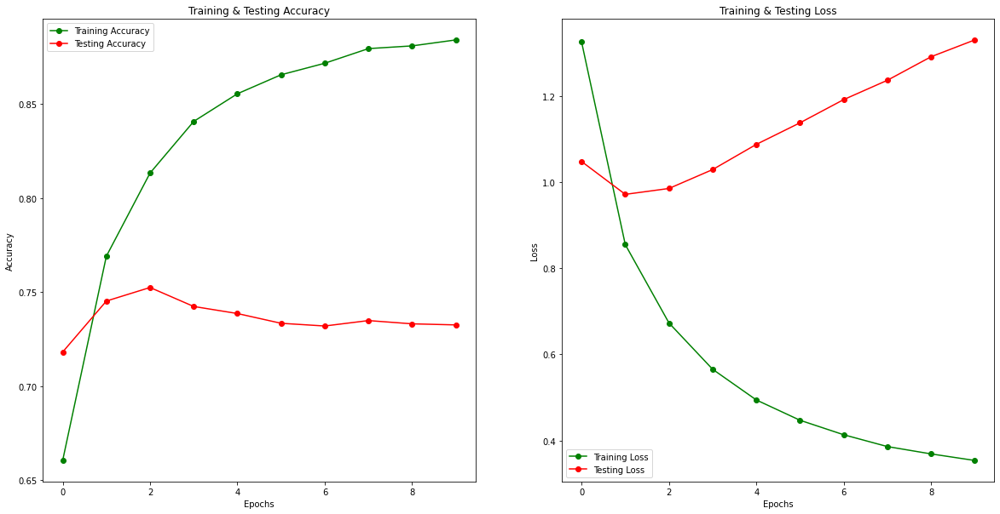

In [163]:
epochs = [i for i in range(10)]
fig , ax = plt.subplots(1,2)
train_acc = history.history['accuracy']
train_loss = history.history['loss']
val_acc = history.history['val_accuracy']
val_loss = history.history['val_loss']
fig.set_size_inches(20,10)

ax[0].plot(epochs , train_acc , 'go-' , label = 'Training Accuracy')
ax[0].plot(epochs , val_acc , 'ro-' , label = 'Testing Accuracy')
ax[0].set_title('Training & Testing Accuracy')
ax[0].legend()
ax[0].set_xlabel("Epochs")
ax[0].set_ylabel("Accuracy")

ax[1].plot(epochs , train_loss , 'go-' , label = 'Training Loss')
ax[1].plot(epochs , val_loss , 'ro-' , label = 'Testing Loss')
ax[1].set_title('Training & Testing Loss')
ax[1].legend()
ax[1].set_xlabel("Epochs")
ax[1].set_ylabel("Loss")
plt.show()

In [156]:
model = load_model('model.h5')

In [157]:
model.evaluate(X_test, y_test)

109/109 [==============================] - 0s 2ms/step - loss: 0.9872 - accuracy: 0.7494


[0.987189769744873, 0.7493510246276855]

In [158]:
print(classification_report(y_test, y_pred, target_names=y_test.columns))

                                                    precision    recall  f1-score   support

                               Parkinson's disease       0.88      0.58      0.70       341
                     amyotrophic lateral sclerosis       0.92      0.69      0.79       351
                                  bipolar disorder       0.95      0.69      0.80       129
                                   diabetes type 2       0.14      0.02      0.03        51
                                          epilepsy       0.45      0.11      0.17        85
                                      fibromyalgia       0.87      0.60      0.71       672
                      generalized anxiety disorder       0.00      0.00      0.00        36
                high blood pressure (hypertension)       0.54      0.17      0.26        41
           high cholesterol (hypercholesterolemia)       0.00      0.00      0.00         5
                                    hypothyroidism       1.00      0.47      0.

/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1272: UndefinedMetricWarning:

Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.

/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1272: UndefinedMetricWarning:

Precision and F-score are ill-defined and being set to 0.0 in samples with no predicted labels. Use `zero_division` parameter to control this behavior.



In [ ]:
# N = 100
# random_x = np.linspace(0, 1, N)
# random_y0 = np.random.randn(N) + 5
# random_y1 = np.random.randn(N)
# random_y2 = np.random.randn(N) - 5

# Create traces
# fig = go.Figure()
# fig.add_trace(go.Scatter(x=alsfrs_score.report_date.values, y=alsfrs_score.score.values,
#                     mode='lines+markers',
#                     name='lines'))

# fig.add_trace(go.Scatter(x=onset_date.first_definitive_diagnosis_date, y=[48]*len(onset_date),
#                     mode='lines+markers',
#                     name='lines'))

# fig.show()